Notes:

- Things to do

    - Should make VisitCatalog, CoaddCatalog, etc. to keep track of what is what (currently hacking with 'id_name' property)
    - Enable millimags
    - Die more gracefully if you're requesting a dud of a func
    - Image viewing on coadd
    - Scatter plot panel for visit
    - skip ccdId in multi_scattersky
    - check matching by comparing visit vs. coadd magnitudes in some way
    - "make-your-own" flag thing
    - warn if a column has nans when making df in QADataset
    
- Interesting points
    - Matching bright things seems bad (absent!) in middle of cosmos (deblending issues?)

In [ ]:
# import sys
# sys.path.insert(0, '/home/tmorton/.local/lib/python3.6/site-packages')


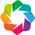

In [1]:
import holoviews as hv
hv.notebook_extension('bokeh')

In [2]:
import dask
import dask.dataframe as dd
import pandas as pd
from distributed import Client
client = Client(scheduler_file='/scratch/tmorton/dask/scheduler.json')

In [18]:
from lsst.daf.persistence import Butler

old_rerun = '/scratch/tmorton/hscRerun/DM-12043/SSP_UDEEP_COSMOS'
rerun44 = '/project/tmorton/DM-12873/w44'
rerun46 = '/project/tmorton/DM-12873/w46'

# butler44 = Butler(rerun44)
# butler46 = Butler(rerun46)
# old_butler = Butler(old_rerun)
rc2 = Butler('/datasets/hsc/repo/rerun/private/lauren/DM-11345/WIDE_VVDS_9697')

# butler = old_butler
butler = rc2

RuntimeError: No default mapper could be established from inputs:[] and no mapper specified for outputs:[RepoData(id=139655543685976,repoArgs=RepositoryArgs(root='/datasets/hsc/repo/rerun/private/lauren/DM-11345/WIDE_VVDS_9697', cfgRoot=None, mapper=None, mapperArgs=None, tags=set(), mode='rw', policy=None)cfg=RepositoryCfg(root='/datasets/hsc/repo/rerun/private/lauren/DM-11345/WIDE_VVDS_9697', mapper=None, mapperArgs={}, parents=[], policy=None),cfgOrigin=new,cfgRoot=/datasets/hsc/repo/rerun/private/lauren/DM-11345/WIDE_VVDS_9697,repo=None,parentRepoDatas=[],isV1Repository=False,role=output,parentRegistry=None)]

In [12]:
from explorer.rc import get_coadd, get_matched, get_color

fields = ['cosmos']#, 'wide-8766', 'wide-8767']
filters = ['HSC-G']#, 'HSC-R', 'HSC-I']#, 'HSC-Z', 'HSC-Y']#, 'NB9021']

catalog = {field : {filt : get_coadd(butler, field, filt) for filt in filters} for field in fields}
matched = {field : {filt : get_matched(butler, field, filt) for filt in filters} for field in fields}
color = {field: {filt : get_color(butler, field, filt) for filt in filters} for field in fields}

In [13]:
# for field in fields:
#     for filt in filters:
#         matched[field][filt].match()

In [14]:
from explorer.dataset import QADataset
from explorer.functors import (Mag, MagDiff, CustomFunctor, DeconvolvedMoments, Column,
                            SdssTraceSize, PsfSdssTraceSizeDiff, HsmTraceSize, Seeing, HsmTraceSize,
                            PsfHsmTraceSizeDiff, CompositeFunctor, StarGalaxyLabeller, NumStarLabeller)


magdiff = MagDiff('modelfit_CModel', 'base_PsfFlux')
magdiff_gauss = MagDiff('base_GaussianFlux', 'base_PsfFlux')
magdiff_kron = MagDiff('ext_photometryKron_KronFlux', 'base_PsfFlux')

funcs = {'gauss': magdiff_gauss} #, 'cmodel':magdiff, 'kron':magdiff_kron, 'seeing':Seeing()}
funcs_matched = {'magdiff':magdiff_gauss} #, 'seeing':Seeing()}
funcs_color = {'wPerp' : Column('wPerp'), 'xPerp' : Column('xPerp'), 'yPerp' : Column('yPerp')}

In [15]:
# magdiff_gauss(matched['wide-8767']['HSC-G']).head()

In [16]:
filt = 'HSC-G'
field = 'cosmos'

In [17]:
from explorer.dataset import QADataset

all_flags = catalog[field][filt].flags
flags = ['calib_psfUsed', 'qaBad_flag']
# flags = all_flags
data = {field : {filt : QADataset(catalog[field][filt], funcs, flags=flags, client=client) for filt in filters} for field in fields}
matched_data = {field : {filt : QADataset(matched[field][filt], funcs_matched, flags=flags, client=client) for filt in filters} for field in fields}
color_data = {field : {filt : QADataset(color[field][filt], funcs_color, flags=['qaBad_flag'], labeller=NumStarLabeller(), client=client) for filt in filters} for field in fields}

FileNotFoundError: [Errno 2] No such file or directory: '/datasets/hsc/repo/rerun/private/lauren/DM-11345/w51/WIDE_VVDS_9697/plots/HSC-G/tract-9813/forced.parq'

In [32]:
%time color_data[field][filt].df.head()

CPU times: user 1.01 s, sys: 118 ms, total: 1.12 s
Wall time: 3.39 s


,dec,label,qaBad_flag,ra,wPerp,x,xPerp,yPerp
id,,,,,,,,


In [23]:
from explorer.plots import FilterStream, multi_scattersky
filter_stream = FilterStream()
multi_scattersky(color_data[field][filt].ds.groupby('label'), filter_stream=filter_stream, width=1200, height=300)

:Layout
   .DynamicMap.I    :DynamicMap   [label]
   .DynamicMap.II   :DynamicMap   [label]
   .DynamicMap.III  :DynamicMap   [label]
   .DynamicMap.IV   :DynamicMap   [label]
   .DynamicMap.V    :DynamicMap   [label]
   .DynamicMap.VI   :DynamicMap   [label]
   .DynamicMap.VII  :DynamicMap   [label]
   .DynamicMap.VIII :DynamicMap   [label]
   .DynamicMap.IX   :DynamicMap   [label]

In [41]:
%time data[field][filt].df.head()

CPU times: user 2.16 s, sys: 174 ms, total: 2.33 s
Wall time: 4.63 s


,calib_psfUsed,dec,gauss,label,qaBad_flag,ra,x
id,,,,,,,
43158167852417027,False,1.512895,1.263488,null,True,150.715336,28.657970
43158167852417029,False,1.513321,-0.421193,null,True,150.722515,28.266774
43158167852417030,False,1.513342,0.276388,null,True,150.719044,26.363254
43158167852417031,False,1.514058,-1.747123,null,True,150.714060,21.048793
43158167852417033,False,1.513844,-0.162787,galaxy,False,150.720147,24.428816


In [42]:
from explorer.plots import FilterStream, multi_scattersky
filter_stream = FilterStream()
multi_scattersky(data[field][filt].ds.groupby('label'), filter_stream=filter_stream, width=900, height=300)

:Layout
   .DynamicMap.I   :DynamicMap   [label]
   .DynamicMap.II  :DynamicMap   [label]
   .DynamicMap.III :DynamicMap   [label]

In [28]:
from explorer.plots import FlagSetter
import parambokeh

flag_setter = FlagSetter(filter_stream=filter_stream, flags=data[field][filt].flags, bad_flags=data[field][filt].flags)
parambokeh.Widgets(flag_setter, callback=flag_setter.event, push=False, on_init=True)

In [36]:
%time matched_data[field][filt].df.head()

distributed.client - WARNING - Client report stream closed to scheduler


CancelledError: <explorer.catalog.AlignWorker object at 0x7f3c14e9c518>-0906f208026d8da792f3618665175b85

In [47]:
data[field][filt].ds

:Dataset   [ra,dec,x,label,patchId,calib_psfUsed,qaBad_flag]   (gauss,cmodel,kron,seeing)

In [23]:
matched_data[field][filt].ds

:Dataset   [ra,dec,x,label,ccdId,calib_psfUsed,qaBad_flag]   (magdiff,seeing,match_distance)

In [48]:
from explorer.plots import FilterStream, multi_scattersky
filter_stream = FilterStream()
multi_scattersky(data[field][filt].ds.groupby('label'), filter_stream=filter_stream, width=1200, height=300)

:Layout
   .DynamicMap.I    :DynamicMap   [label]
   .DynamicMap.II   :DynamicMap   [label]
   .DynamicMap.III  :DynamicMap   [label]
   .DynamicMap.IV   :DynamicMap   [label]
   .DynamicMap.V    :DynamicMap   [label]
   .DynamicMap.VI   :DynamicMap   [label]
   .DynamicMap.VII  :DynamicMap   [label]
   .DynamicMap.VIII :DynamicMap   [label]
   .DynamicMap.IX   :DynamicMap   [label]
   .DynamicMap.X    :DynamicMap   [label]
   .DynamicMap.XI   :DynamicMap   [label]
   .DynamicMap.XII  :DynamicMap   [label]

In [55]:
from explorer.plots import FlagSetter
import parambokeh

flag_setter = FlagSetter(filter_stream=filter_stream, flags=data[field][filt].flags, bad_flags=data[field][filt].flags)
parambokeh.Widgets(flag_setter, callback=flag_setter.event, push=False, on_init=True)

In [23]:
import lsst.afw.display
lsst.afw.display.setDefaultBackend("ginga")
display = lsst.afw.display.Display(dims=(200, 200))
display.embed()

Image(value=b'', format='jpeg', height='200', width='200')

In [58]:
%%output max_frames=10000
%%opts Points [width=500, height=400, tools=['hover'], colorbar=True] (cmap='coolwarm', size=4)

from holoviews.operation import decimate
from explorer.plots import scattersky, multi_scattersky, FilterStream

dmap = matched_data[field][filt].visit_explore('seeing', filter_stream=filter_stream)

tap = hv.streams.Tap(source=dmap, rename={'x':'ra', 'y':'dec'})

dmap

:DynamicMap   [visit,x_max,label]

In [59]:
from explorer.match import match_lists
import numpy as np

from lsst.daf.persistence import Butler
import lsst.afw.coord as afwCoord
import lsst.afw.geom as afwGeom
import lsst.afw.image as afwImage

def find_closest(dmap, ra, dec):
    df = dmap.values()[0].data
    _, ind = match_lists(np.array([float(ra)]), np.array([float(dec)]), df.ra, df.dec, 1.)
    return df.iloc[ind]

def get_subexp(dmap, ra, dec, filt='HSC-G', tract=8766, width=100, height=100):
    visit = int(dmap.keys()[0][0])
    obj = find_closest(dmap, ra, dec)
    ccd = int(obj.ccdId.iloc[0])
    dataId = dict(visit=visit, filter=filt, ccd=ccd)
    exp = butler.get('calexp', dataId=dataId)
    
    ra, dec = obj.ra.iloc[0], obj.dec.iloc[0]
    pos = afwCoord.IcrsCoord(ra*afwGeom.degrees, dec*afwGeom.degrees) 
    wcs = exp.getWcs()
    pixel = afwGeom.Point2I(wcs.skyToPixel(pos))
    box = afwGeom.Box2I()  # empty
    box.include(pixel)  # one pixel
    box.grow(afwGeom.Extent2I(width, height))
    sub = exp[box, afwImage.PARENT]    
    return sub

def update_ginga(ra, dec, display=None, dmap=None, **kwargs):
    print(ra, dec)
    sub = get_subexp(dmap, ra, dec, **kwargs)
    display.mtv(sub)

from functools import partial
tap.add_subscriber(partial(update_ginga,display=display, dmap=dmap))

In [16]:
%%output max_frames=10000
%%opts Points [width=500, height=400, tools=['hover'], colorbar=True] (cmap='coolwarm', size=4)

from holoviews.operation import decimate
from explorer.plots import scattersky, multi_scattersky, FilterStream
filter_stream = FilterStream()

# dmap = matched_data['HSC-G'].visit_explore('magdiff', filter_stream=filter_stream)

dmap1 = matched_data[field][filt].visit_explore('magdiff', filter_stream=filter_stream)
dmap2 = matched_data[field][filt].visit_explore('seeing', filter_stream=filter_stream)

tap = hv.streams.Tap(source=dmap1, rename={'x':'ra', 'y':'dec'})

# (dmap1 + dmap2).cols(1)

# tap = hv.streams.Tap(source=dmap, rename={'x':'ra', 'y':'dec'})
# dmap

dmap1 + dmap2

:Layout
   .DynamicMap.I  :DynamicMap   [visit,x_max,label]
   .DynamicMap.II :DynamicMap   [visit,x_max,label]